In [1]:
import pandas as pd
import numpy as np

In [26]:
id_map = pd.read_csv('/itf-fi-ml/shared/users/ziyuzh/svm/data/uniport_id/idmapping_string.tsv', sep ='\t')
id_map.head(2)

,From,Entry
0,9606.ENSP00000000233,P84085
1,9606.ENSP00000356607,Q86X27


In [31]:
map_dict = id_map.set_index('Entry')['From'].to_dict()

In [ ]:
import h5py

# Replace 'your_file.h5' with the path to your .h5 file
file_path = '/itf-fi-ml/shared/users/ziyuzh/svm/data/pre_processed_features/seq_emb/per-protein.h5'
f = h5py.File(file_path, 'r')

In [27]:
intersection = set(id_map['Entry'].tolist())&set(list(f.keys()))

In [34]:
with h5py.File(file_path, 'r') as f:
    # Prepare a list to collect data
    collected_data = []
    index_labels = []

    for id in intersection:
        if id in f:
            # Retrieve data associated with the current id from the file
            data = f[id][:]
            # Collect data and corresponding index label
            collected_data.append(data)
            index_labels.append(map_dict[id])

    # If any data was collected, create DataFrame
    if collected_data:
        # Assumes each data is a 1D array, concatenate them into a 2D array
        data_matrix = pd.DataFrame(collected_data, index=index_labels)


In [38]:
data_matrix

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
9606.ENSP00000347277,0.036804,-0.014359,0.044525,0.019196,-0.083923,0.059784,0.009300,-0.084167,0.037445,0.061371,...,-0.010201,-0.001774,0.024857,-0.000448,-0.040314,-0.022812,-0.049652,0.030502,0.052734,0.023621
9606.ENSP00000368528,0.062073,-0.036438,0.012863,0.006859,-0.025665,0.100220,-0.030136,-0.086243,0.026398,0.002237,...,-0.089050,0.021866,0.008926,0.021774,0.037354,-0.081787,-0.070618,-0.038910,0.035126,0.046600
9606.ENSP00000321735,-0.000283,0.095398,0.024353,-0.006847,-0.016617,0.010857,-0.019012,-0.026154,0.003408,-0.022690,...,-0.021835,-0.025497,0.016190,-0.004097,-0.027893,-0.024689,0.005859,-0.029480,0.007755,0.044342
9606.ENSP00000490107,0.067688,0.103271,0.049377,0.058624,0.013550,0.088257,-0.031921,-0.040680,0.011055,-0.035828,...,-0.027756,-0.039154,-0.022934,0.020004,0.041656,-0.030685,0.015762,0.039307,-0.049377,0.020126
9606.ENSP00000375108,-0.034363,0.163818,-0.046204,-0.026566,0.081665,-0.069214,-0.007988,-0.102051,0.068970,-0.087891,...,0.086182,-0.132080,-0.188843,-0.055237,0.116760,-0.085327,0.021255,-0.039520,-0.016281,0.061523
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9606.ENSP00000353734,-0.029984,0.045166,0.024048,0.035217,-0.022461,0.044342,-0.025238,-0.009277,0.039734,-0.011002,...,0.009857,0.011208,-0.037231,-0.008789,0.040222,0.075439,-0.037354,-0.028748,-0.039703,0.015518
9606.ENSP00000261789,0.008255,0.105957,0.027405,-0.000701,0.015274,0.017746,-0.012329,-0.012192,0.018784,-0.039154,...,0.011879,-0.002985,0.006424,0.003054,0.017532,-0.001849,-0.014198,0.005447,-0.015503,0.020645
9606.ENSP00000498786,0.041687,0.034149,0.016800,0.036804,-0.038116,0.056519,-0.070740,-0.076843,0.027359,0.012154,...,-0.048737,-0.008469,0.033203,-0.017456,0.011230,-0.049683,-0.053680,-0.009583,-0.001243,0.013115
9606.ENSP00000363873,0.092224,-0.004875,0.061554,0.004951,-0.066650,0.067322,0.034332,-0.069885,0.035706,0.126465,...,-0.047241,-0.042236,0.072632,-0.022934,-0.054413,-0.062744,-0.041840,0.020691,0.111145,0.102173


In [ ]:
data_matrix.columns = [f'feature_{i}' for i in data_matrix.columns]
data_matrix = data_matrix.reset_index().rename(columns={'index': 'string_id'})

data_matrix.head(2)

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_1014,feature_1015,feature_1016,feature_1017,feature_1018,feature_1019,feature_1020,feature_1021,feature_1022,feature_1023
9606.ENSP00000347277,0.036804,-0.014359,0.044525,0.019196,-0.083923,0.059784,0.009300,-0.084167,0.037445,0.061371,...,-0.010201,-0.001774,0.024857,-0.000448,-0.040314,-0.022812,-0.049652,0.030502,0.052734,0.023621
9606.ENSP00000368528,0.062073,-0.036438,0.012863,0.006859,-0.025665,0.100220,-0.030136,-0.086243,0.026398,0.002237,...,-0.089050,0.021866,0.008926,0.021774,0.037354,-0.081787,-0.070618,-0.038910,0.035126,0.046600


In [47]:
data_matrix.to_csv('/itf-fi-ml/shared/users/ziyuzh/svm/data/pre_processed_features/seq_emb/human_uniport_seqemb.csv',index=False)

In [1]:
import pandas as pd

In [2]:
data_matrix = pd.read_csv('/itf-fi-ml/shared/users/ziyuzh/svm/data/pre_processed_features/seq_emb/human_uniport_seqemb.csv')

In [3]:
data_matrix.head(3)

,string_id,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,...,feature_1014,feature_1015,feature_1016,feature_1017,feature_1018,feature_1019,feature_1020,feature_1021,feature_1022,feature_1023
0,9606.ENSP00000347277,0.036800,-0.01436,0.04453,0.019200,-0.08390,0.05978,0.00930,-0.08417,0.037450,...,-0.01020,-0.001774,0.02486,-0.000447,-0.04030,-0.02281,-0.04965,0.03050,0.052730,0.02362
1,9606.ENSP00000368528,0.062070,-0.03644,0.01286,0.006860,-0.02567,0.10020,-0.03014,-0.08624,0.026400,...,-0.08905,0.021870,0.00893,0.021770,0.03735,-0.08180,-0.07060,-0.03890,0.035130,0.04660
2,9606.ENSP00000321735,-0.000283,0.09540,0.02435,-0.006847,-0.01662,0.01086,-0.01901,-0.02615,0.003408,...,-0.02184,-0.025500,0.01619,-0.004097,-0.02790,-0.02469,0.00586,-0.02948,0.007755,0.04434


In [4]:
data_matrix = data_matrix.set_index('string_id')

In [5]:
from sklearn.metrics.pairwise import cosine_similarity

# Calculate cosine similarity between all rows
cos_sim_matrix = cosine_similarity(data_matrix.values)

# Convert it back to a dataframe if you want labeled rows/columns
cos_sim_df = pd.DataFrame(cos_sim_matrix, index=data_matrix.index, columns=data_matrix.index)

In [6]:
cos_sim_df

string_id,9606.ENSP00000347277,9606.ENSP00000368528,9606.ENSP00000321735,9606.ENSP00000490107,9606.ENSP00000375108,9606.ENSP00000272217,9606.ENSP00000219833,9606.ENSP00000304268,9606.ENSP00000417559,9606.ENSP00000378731,...,9606.ENSP00000284273,9606.ENSP00000357917,9606.ENSP00000383690,9606.ENSP00000479370,9606.ENSP00000225655,9606.ENSP00000353734,9606.ENSP00000261789,9606.ENSP00000498786,9606.ENSP00000363873,9606.ENSP00000359484
string_id,,,,,,,,,,,,,,,,,,,,,
9606.ENSP00000347277,1.000000,0.519192,0.447661,0.218695,0.209727,0.254371,0.350282,0.097902,0.324666,0.305618,...,0.307199,0.424625,0.323692,0.376352,0.292097,0.380269,0.274190,0.361723,0.716048,0.434914
9606.ENSP00000368528,0.519192,1.000000,0.428257,0.317812,0.293089,0.340043,0.458308,0.197675,0.378184,0.385168,...,0.421260,0.324775,0.356425,0.451851,0.447141,0.321305,0.395552,0.438196,0.445817,0.486884
9606.ENSP00000321735,0.447661,0.428257,1.000000,0.477084,0.263456,0.451619,0.650252,0.252544,0.344950,0.491897,...,0.432139,0.311468,0.523581,0.488649,0.329023,0.498145,0.561032,0.461841,0.501482,0.469018
9606.ENSP00000490107,0.218695,0.317812,0.477084,1.000000,0.155758,0.623528,0.670095,0.266354,0.515181,0.557895,...,0.518490,0.214383,0.421505,0.400898,0.269438,0.408843,0.599722,0.411181,0.211737,0.435784
9606.ENSP00000375108,0.209727,0.293089,0.263456,0.155758,1.000000,0.178235,0.242203,0.335016,0.131479,0.184214,...,0.157421,0.164823,0.201915,0.212328,0.156398,0.192825,0.257867,0.132685,0.150341,0.267808
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9606.ENSP00000353734,0.380269,0.321305,0.498145,0.408843,0.192825,0.355110,0.415667,0.382775,0.366255,0.322092,...,0.445317,0.387847,0.489801,0.365729,0.224186,1.000000,0.414744,0.312193,0.389805,0.572111
9606.ENSP00000261789,0.274190,0.395552,0.561032,0.599722,0.257867,0.623888,0.746107,0.262546,0.572323,0.554721,...,0.441758,0.322943,0.543808,0.425290,0.436312,0.414744,1.000000,0.448365,0.246536,0.439050
9606.ENSP00000498786,0.361723,0.438196,0.461841,0.411181,0.132685,0.506919,0.539670,0.204262,0.488932,0.649584,...,0.573215,0.278750,0.450593,0.556985,0.519067,0.312193,0.448365,1.000000,0.374260,0.451062


In [35]:
cos_sim_df.min().min()

-0.11477635026387119

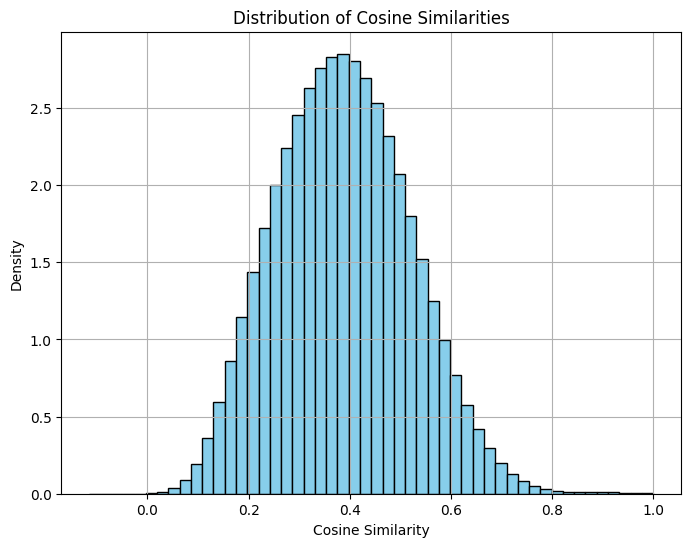

In [7]:
import matplotlib.pyplot as plt

# Flatten the matrix
cos_sim_values = cos_sim_df.values.flatten()

# Remove self-similarity (diagonal = 1)
cos_sim_values = cos_sim_values[cos_sim_values != 1]

# Plot histogram
plt.figure(figsize=(8, 6))
plt.hist(cos_sim_values, bins=50, color='skyblue', edgecolor='black', density=True)
plt.title('Distribution of Cosine Similarities')
plt.xlabel('Cosine Similarity')
plt.ylabel('Density')
plt.grid(True)
plt.show()


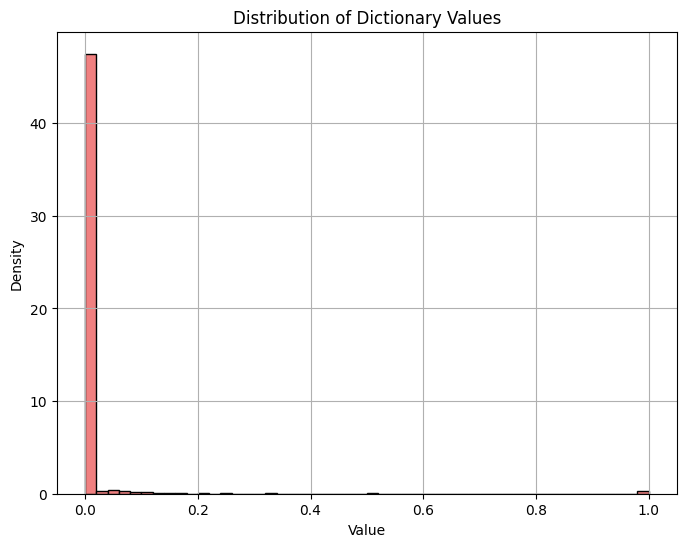

In [9]:
import pickle
with open("/itf-fi-ml/shared/users/ziyuzh/svm/data/kegg/kegg_sim.pkl", "rb") as f:
    kegg_features = pickle.load(f)

# Extract values
values = list(kegg_features.values())

# Plot histogram
plt.figure(figsize=(8, 6))
plt.hist(values, bins=50, color='lightcoral', edgecolor='black', density=True)
plt.title('Distribution of Dictionary Values')
plt.xlabel('Value')
plt.ylabel('Density')

plt.grid(True)
plt.show()


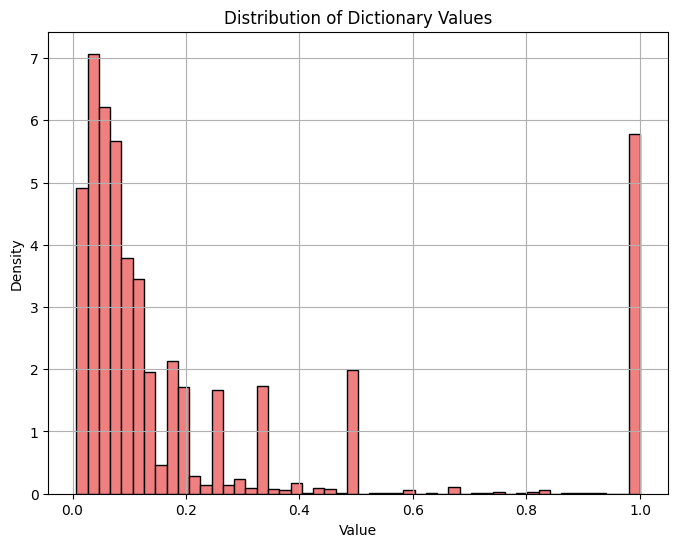

In [10]:
non_0_values = [x for x in values if x != 0]
# Plot histogram
plt.figure(figsize=(8, 6))
plt.hist(non_0_values, bins=50, color='lightcoral', edgecolor='black', density=True)
plt.title('Distribution of Dictionary Values')
plt.xlabel('Value')
plt.ylabel('Density')

plt.grid(True)
plt.show()

In [26]:
with open("/itf-fi-ml/shared/users/ziyuzh/svm/data/kegg/kegg_features.pkl", "rb") as f:
    kegg_annotations = pickle.load(f)

In [ ]:
from itertools import product
keys = list(kegg_annotations.keys())

# Initialize an empty DataFrame
kegg_df = pd.DataFrame(index=keys, columns=keys, dtype=float)

# Define a function to calculate Jaccard similarity
def jaccard(set1, set2):
    set1, set2 = set(set1), set(set2)
    return len(set1 & set2) / len(set1 | set2)

# Fill the DataFrame
for key1, key2 in product(keys, repeat=2):
    kegg_df.loc[key1, key2] = jaccard(kegg_annotations[key1], kegg_annotations[key2])

In [32]:
kegg_df

,9606.ENSP00000344155,9606.ENSP00000494609,9606.ENSP00000272286,9606.ENSP00000301732,9606.ENSP00000333926,9606.ENSP00000497274,9606.ENSP00000363868,9606.ENSP00000285238,9606.ENSP00000284425,9606.ENSP00000494321,...,9606.ENSP00000278903,9606.ENSP00000356737,9606.ENSP00000397157,9606.ENSP00000415430,9606.ENSP00000314946,9606.ENSP00000306682,9606.ENSP00000430945,9606.ENSP00000329213,9606.ENSP00000478931,9606.ENSP00000311221
9606.ENSP00000344155,1.00,0.250000,0.20,0.500000,0.500000,0.333333,0.200000,0.333333,0.500000,0.250000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9606.ENSP00000494609,0.25,1.000000,0.40,0.333333,0.333333,0.666667,0.166667,0.666667,0.333333,0.200000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9606.ENSP00000272286,0.20,0.400000,1.00,0.250000,0.250000,0.500000,0.600000,0.500000,0.250000,0.166667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9606.ENSP00000301732,0.50,0.333333,0.25,1.000000,1.000000,0.500000,0.250000,0.500000,1.000000,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9606.ENSP00000333926,0.50,0.333333,0.25,1.000000,1.000000,0.500000,0.250000,0.500000,1.000000,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9606.ENSP00000306682,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
9606.ENSP00000430945,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
9606.ENSP00000329213,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
9606.ENSP00000478931,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [39]:
len(set(cos_sim_df.columns.tolist())), len(set(kegg_df.columns.tolist())), len(set(cos_sim_df.columns.tolist()).union(set(kegg_df.columns.tolist())))


(18847, 7794, 18987)

In [41]:
# Get the union of both dataframes' indices and columns
all_ids = set(cos_sim_df.index).union(set(cos_sim_df.columns)).union(set(kegg_df.index)).union(set(kegg_df.columns))

# Reindex both dataframes with the union of all IDs and fill missing values with 0
expanded_cos_sim_df = cos_sim_df.reindex(index=all_ids, columns=all_ids, fill_value=0)
expanded_kegg_df = kegg_df.reindex(index=all_ids, columns=all_ids, fill_value=0)


In [44]:
(cos_sim_df == 0).sum().sum(),(expanded_cos_sim_df == 0).sum().sum(),(kegg_df == 0).sum().sum(),(expanded_kegg_df == 0).sum().sum()

(0, 5296760, 57525830, 357285563)

In [45]:
expanded_cos_sim_df.index.equals(expanded_kegg_df.index)

True

In [ ]:
18987**2 - (weighted_scores == 0).sum().sum()

(360506169,)

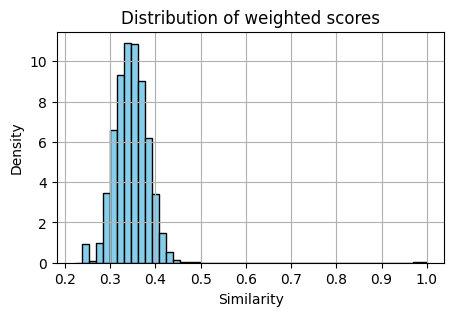

In [ ]:
# weighted_scores = 0.7*expanded_kegg_df+0.3*((expanded_cos_sim_df+1)/2)**2
weighted_scores = 0.5*expanded_kegg_df+0.5*((expanded_cos_sim_df+1)/2)



# Flatten the matrix
cos_sim_values = weighted_scores.values.flatten()

# Remove self-similarity (diagonal = 1)
cos_sim_values = cos_sim_values[cos_sim_values != 1]

# Plot histogram
plt.figure(figsize=(5, 3))
plt.hist(cos_sim_values, bins=50, color='skyblue', edgecolor='black', density=True)
plt.title('Distribution of weighted scores')
plt.xlabel('Similarity')
plt.ylabel('Density')
plt.grid(True)
plt.show()

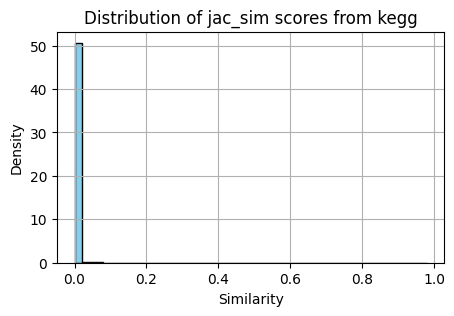

In [64]:
# Flatten the matrix
cos_sim_values = expanded_kegg_df.values.flatten()

# Remove self-similarity (diagonal = 1)
cos_sim_values = cos_sim_values[cos_sim_values != 1]

# Plot histogram
plt.figure(figsize=(5, 3))
plt.hist(cos_sim_values, bins=50, color='skyblue', edgecolor='black', density=True)
plt.title('Distribution of jac_sim scores from kegg')
plt.xlabel('Similarity')
plt.ylabel('Density')
plt.grid(True)
plt.show()

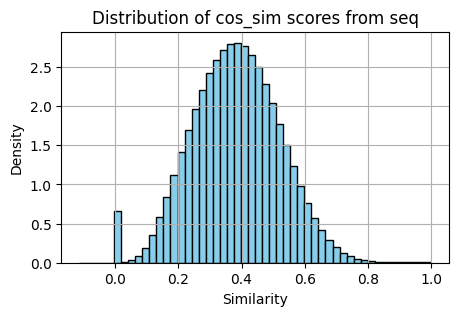

In [63]:
# Flatten the matrix
cos_sim_values = expanded_cos_sim_df.values.flatten()

# Remove self-similarity (diagonal = 1)
cos_sim_values = cos_sim_values[cos_sim_values != 1]

# Plot histogram
plt.figure(figsize=(5, 3))
plt.hist(cos_sim_values, bins=50, color='skyblue', edgecolor='black', density=True)
plt.title('Distribution of cos_sim scores from seq')
plt.xlabel('Similarity')
plt.ylabel('Density')
plt.grid(True)
plt.show()